In [91]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet, ElasticNetCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error
import statsmodels.api as sm
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import classification_report

from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import NearMiss
from sklearn.svm import SVR


# Выводы:
Нормализация мешает везде, кроме sigmoid kernel. Это происходит из-за того, что SVM больше смотрит на
"геометрическое" положение точек, а про нормализации расстояние между точками уменьшается, они сгущаются, могут большее
влияние оказывать погрешности
1. Aggregation:
   <br>
   Хорошо справляются linear,polynomial,rbf
   <br>
    rbf выделяет области вокруг локальных классов, при этом определяя пространство
    между классами как область того класса, который сильнее "раскидан". В нашей задаче это плохо.
   <br>
   Polynomial лучше определяет изгибы границ областей, чем linear, поэтому выбираем его.
3. Compound:
   <br>
   Здесь однозначно rbf, так как некоторые из классов "окружены" другими
5. Path-based:
   <br>
   Здесь rbf с g=0.1,c=0.1
   При бОльшх gamma происходит переобучение
7. Flame:
   <br>
   rbf g = 0.1 и с = 10
9. Jain:
   <br>
   rbf с gamma = 0.1 и c = 0.1
   <br>
   Также неплохо отрабатывает polinomial
10. Spiral:
    <br>
   только rbf, лучший результат с g = 0.1, c = 10

## Для задачи регрессии:
Лучший результат при использовании rbf
<br>
получаем MSE ~ 0.1

In [2]:
from sklearn import svm

In [3]:
df_aggr = pd.read_csv('Aggregation.txt', sep="\t", header=None)
df_aggr.columns = ["x","y","type"]

In [204]:
df_comp = pd.read_csv('Compound.txt', sep="\t", header=None)
df_comp.columns = ["x","y","type"]

In [5]:
df_path = pd.read_csv('Pathbased.txt', sep="\t", header=None)
df_path.columns = ["x","y","type"]

In [6]:
df_spiral = pd.read_csv('Spiral.txt', sep="\t", header=None)
df_spiral.columns = ["x","y","type"]

In [7]:
df_jain = pd.read_csv('Jain.txt', sep="\t", header=None)
df_jain.columns = ["x","y","type"]

In [8]:
df_flame = pd.read_csv('Flame.txt', sep="\t", header=None)
df_flame.columns = ["x","y","type"]

In [9]:
df_aggr


,x,y,type
0,15.55,28.65,2
1,14.90,27.55,2
2,14.45,28.35,2
3,14.15,28.80,2
4,13.75,28.05,2
...,...,...,...
783,7.80,3.35,5
784,8.05,2.75,5
785,8.50,3.25,5
786,8.10,3.55,5


In [10]:
y_aggr = df_aggr['type']
df_aggr = df_aggr.drop('type',axis = 1)

In [207]:
y_comp = df_comp['type']
df_comp = df_comp.drop('type',axis = 1)

In [12]:
y_path = df_path['type']
df_path = df_path.drop('type',axis = 1)

In [13]:
y_jain = df_jain['type']
df_jain = df_jain.drop('type',axis = 1)

In [14]:
y_spiral = df_spiral['type']
df_spiral= df_spiral.drop('type',axis = 1)

In [15]:
y_flame = df_flame['type']
df_flame = df_flame.drop('type',axis = 1)

In [16]:
np.min(y_aggr)

1

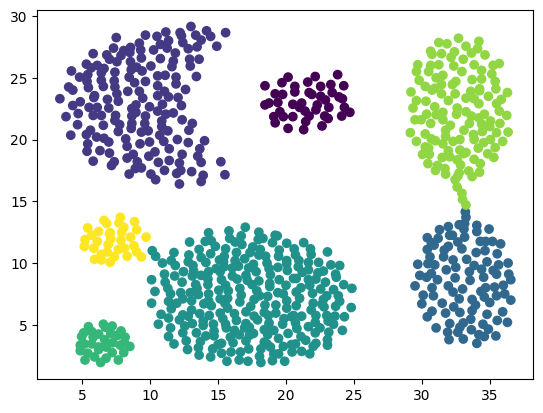

In [17]:
plt.scatter(df_aggr['x'],df_aggr['y'], c = y_aggr)


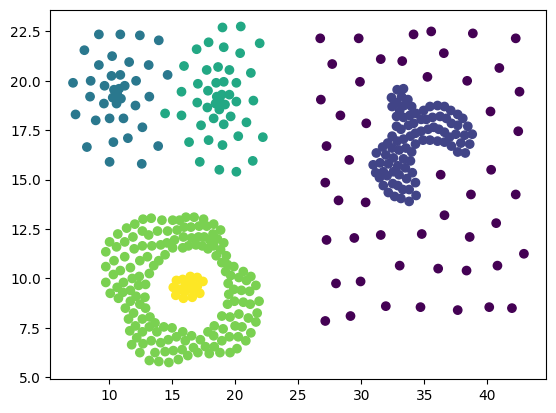

In [18]:
plt.scatter(df_comp['x'],df_comp['y'], c = y_comp)


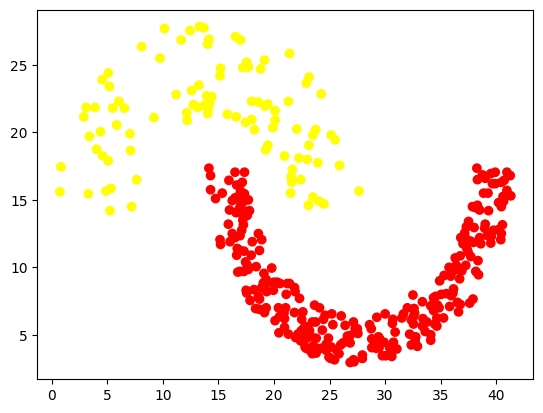

In [19]:
plt.scatter(df_jain['x'],df_jain['y'], c = y_jain, cmap = 'autumn')


In [20]:
colors_spiral = ['red','green','blue']

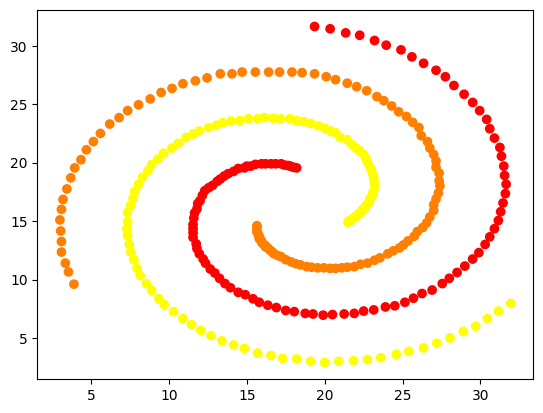

In [21]:
plt.scatter(df_spiral['x'],df_spiral['y'], c = y_spiral, cmap = 'autumn')


In [22]:
colors_flame = ['red','green']

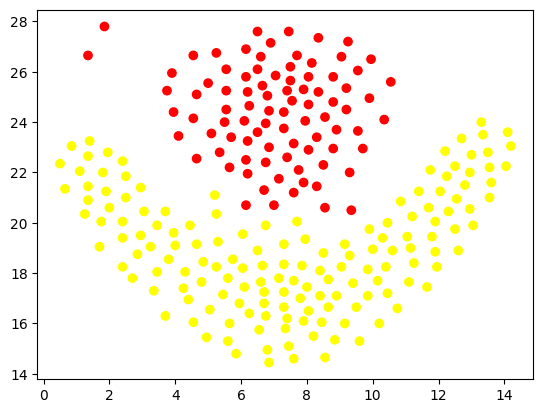

In [23]:
plt.scatter(df_flame['x'],df_flame['y'], c = y_flame, cmap = 'autumn')


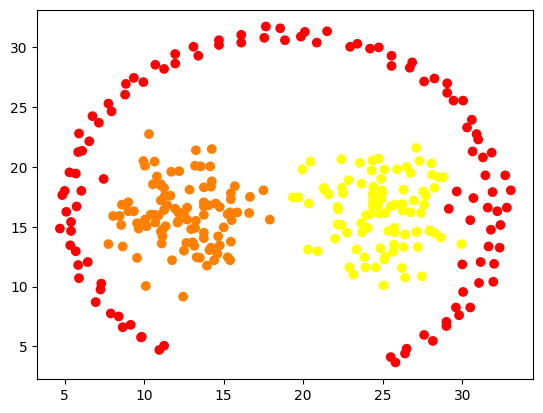

In [24]:
plt.scatter(df_path['x'],df_path['y'], c = y_path, cmap = 'autumn')


In [25]:
clf = svm.SVC(kernel='rbf')
clf.fit(df_aggr, y_aggr)

SVC()

In [31]:
X_path_train, X_path_test, y_path_train, y_path_test = train_test_split(df_path, y_path, test_size=0.3, random_state=42)

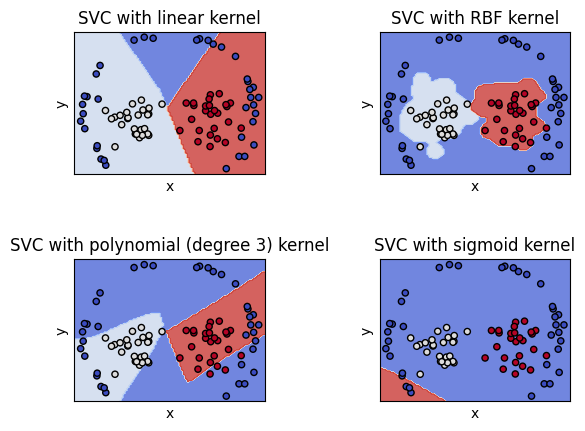

In [35]:
import matplotlib.pyplot as plt

from sklearn import datasets, svm
from sklearn.inspection import DecisionBoundaryDisplay

# import some data to play with
#iris = datasets.load_iris()
# Take the first two features. We could avoid this by using a two-dim dataset
X = X_path_train
y = y_path_train
# we create an instance of SVM and fit out data. We do not scale our
# data since we want to plot the support vectors
C = 1.0  # SVM regularization parameter
models = (
    svm.SVC(kernel="linear", C=C),
    svm.SVC(kernel="rbf", gamma=0.7, C=C),
    svm.SVC(kernel="poly", degree=3, gamma="auto", C=C),
    svm.SVC(kernel="sigmoid", C=C),

)
models = (clf.fit(X, y) for clf in models)

# title for the plots
titles = (
    "SVC with linear kernel",
    "SVC with RBF kernel",
    "SVC with polynomial (degree 3) kernel",
    "SVC with sigmoid kernel",

)

# Set-up 2x2 grid for plotting.
fig, sub = plt.subplots(2, 2)
plt.subplots_adjust(wspace=0.6, hspace=0.6)

X0, X1 = X_path_test['x'], X_path_test['y']

for clf, title, ax in zip(models, titles, sub.flatten()):
    disp = DecisionBoundaryDisplay.from_estimator(
        clf,
        X_path_test,
        response_method="predict",
        cmap=plt.cm.coolwarm,
        alpha=0.8,
        ax=ax,
        xlabel='x',
        ylabel='y',
    )
    ax.scatter(X0, X1, c=y_path_test, cmap=plt.cm.coolwarm, s=20, edgecolors="k")
    ax.set_xticks(())
    ax.set_yticks(())
    ax.set_title(title)

plt.show()

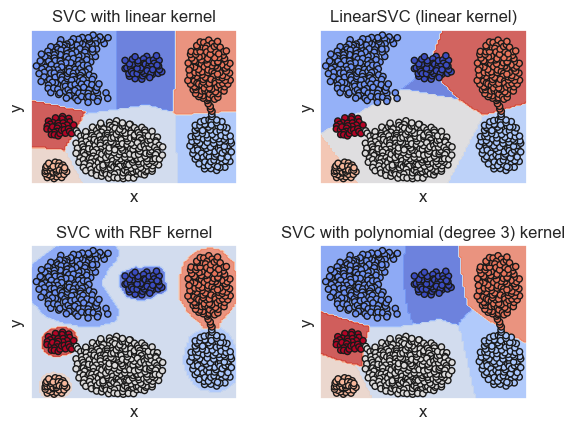

In [106]:
import matplotlib.pyplot as plt

from sklearn import datasets, svm
from sklearn.inspection import DecisionBoundaryDisplay

# import some data to play with
#iris = datasets.load_iris()
# Take the first two features. We could avoid this by using a two-dim dataset
X = df_aggr
y = y_aggr
# we create an instance of SVM and fit out data. We do not scale our
# data since we want to plot the support vectors
C = 1.0  # SVM regularization parameter
models = (
    svm.SVC(kernel="linear", C=C),
    svm.LinearSVC(C=C, max_iter=10000),
    svm.SVC(kernel="rbf", gamma=0.7, C=C),
    svm.SVC(kernel="poly", degree=3, gamma="auto", C=C),
)
models = (clf.fit(X, y) for clf in models)

# title for the plots
titles = (
    "SVC with linear kernel",
    "LinearSVC (linear kernel)",
    "SVC with RBF kernel",
    "SVC with polynomial (degree 3) kernel",
)

# Set-up 2x2 grid for plotting.
fig, sub = plt.subplots(2, 2)
plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X['x'], X['y']

for clf, title, ax in zip(models, titles, sub.flatten()):
    disp = DecisionBoundaryDisplay.from_estimator(
        clf,
        X,
        response_method="predict",
        cmap=plt.cm.coolwarm,
        alpha=0.8,
        ax=ax,
        xlabel='x',
        ylabel='y',
    )
    ax.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors="k")
    ax.set_xticks(())
    ax.set_yticks(())
    ax.set_title(title)

plt.show()

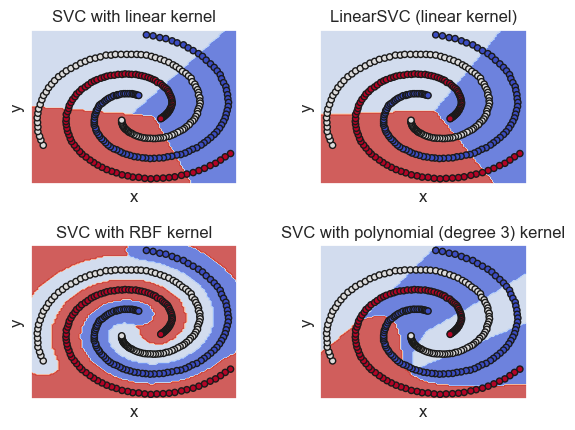

In [107]:
import matplotlib.pyplot as plt

from sklearn import datasets, svm
from sklearn.inspection import DecisionBoundaryDisplay

# import some data to play with
#iris = datasets.load_iris()
# Take the first two features. We could avoid this by using a two-dim dataset
X = df_spiral
y = y_spiral
# we create an instance of SVM and fit out data. We do not scale our
# data since we want to plot the support vectors
C = 1.0  # SVM regularization parameter
models = (
    svm.SVC(kernel="linear", C=C),
    svm.LinearSVC(C=C, max_iter=10000),
    svm.SVC(kernel="rbf", gamma=0.7, C=C),
    svm.SVC(kernel="poly", degree=3, gamma="auto", C=C),
)
models = (clf.fit(X, y) for clf in models)

# title for the plots
titles = (
    "SVC with linear kernel",
    "LinearSVC (linear kernel)",
    "SVC with RBF kernel",
    "SVC with polynomial (degree 3) kernel",
)

# Set-up 2x2 grid for plotting.
fig, sub = plt.subplots(2, 2)
plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X['x'], X['y']

for clf, title, ax in zip(models, titles, sub.flatten()):
    disp = DecisionBoundaryDisplay.from_estimator(
        clf,
        X,
        response_method="predict",
        cmap=plt.cm.coolwarm,
        alpha=0.8,
        ax=ax,
        xlabel='x',
        ylabel='y',
    )
    ax.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors="k")
    ax.set_xticks(())
    ax.set_yticks(())
    ax.set_title(title)

plt.show()

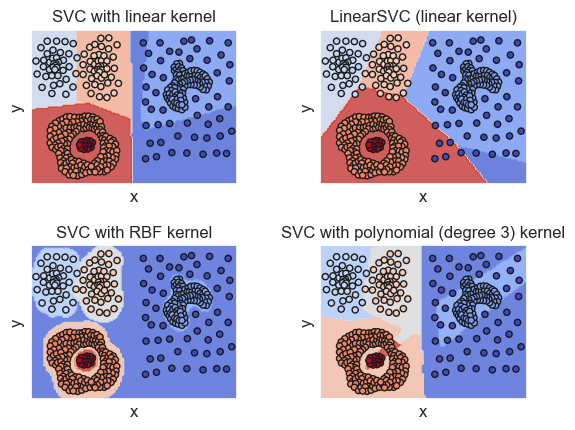

In [108]:
import matplotlib.pyplot as plt

from sklearn import datasets, svm
from sklearn.inspection import DecisionBoundaryDisplay

# import some data to play with
#iris = datasets.load_iris()
# Take the first two features. We could avoid this by using a two-dim dataset
X = df_comp
y = y_comp
# we create an instance of SVM and fit out data. We do not scale our
# data since we want to plot the support vectors
C = 1.0  # SVM regularization parameter
models = (
    svm.SVC(kernel="linear", C=C),
    svm.LinearSVC(C=C, max_iter=10000),
    svm.SVC(kernel="rbf", gamma=0.7, C=C),
    svm.SVC(kernel="poly", degree=3, gamma="auto", C=C),
)
models = (clf.fit(X, y) for clf in models)

# title for the plots
titles = (
    "SVC with linear kernel",
    "LinearSVC (linear kernel)",
    "SVC with RBF kernel",
    "SVC with polynomial (degree 3) kernel",
)

# Set-up 2x2 grid for plotting.
fig, sub = plt.subplots(2, 2)
plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X['x'], X['y']

for clf, title, ax in zip(models, titles, sub.flatten()):
    disp = DecisionBoundaryDisplay.from_estimator(
        clf,
        X,
        response_method="predict",
        cmap=plt.cm.coolwarm,
        alpha=0.8,
        ax=ax,
        xlabel='x',
        ylabel='y',
    )
    ax.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors="k")
    ax.set_xticks(())
    ax.set_yticks(())
    ax.set_title(title)

plt.show()

In [473]:
import matplotlib.pyplot as plt

from sklearn import datasets, svm
from sklearn.inspection import DecisionBoundaryDisplay
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, ConfusionMatrixDisplay

gamma_arr = [0.1,1,10]
c_arr = [0.1,1,10]
kernels = ['rbf','linear']
models = []
for kernel in kernels:
    for gamma in gamma_arr:
        for c in c_arr:
            if kernel == 'linear':
                models.append(svm.SVC(kernel=kernel, C=c))
            else:
                models.append(svm.SVC(kernel=kernel, gamma=gamma, C=c))


titles = []
for kernel in kernels:
    for gamma in gamma_arr:
        for c in c_arr:
            titles.append(f"SVC with {kernel} kernel g={gamma}, c={c}")


c_arr = [0.1,1,10,1000,10000]
gamma_arr = ['scale']
kernel = 'sigmoid'
for gamma in gamma_arr:
    for c in c_arr:
        models.append(svm.SVC(kernel=kernel, gamma=gamma, C=c))

for gamma in gamma_arr:
    for c in c_arr:
        titles.append(f"SVC with {kernel} kernel g={gamma}, c={c}")

    
def print_SVM_plots(X_train,y_train,X_test,y_test,models,titles,print_SV = False,
                    print_contours = False,return_params_df = False,return_models = False,print_params = False):
    m = len(models) // 3 if len(models) % 3 == 0 else len(models) // 3 + 1
    models = (clf.fit(X_train, y_train) for clf in models)
    
    # Set-up 2x2 grid for plotting.
    fig, sub = plt.subplots(m, 3)
    plt.subplots_adjust(wspace=0.2, hspace=0.5)
    my = max(y_train)
    X0, X1 = X_test['x'], X_test['y']
    if return_params_df:
        columns_ = ['kernel','gamma', 'C']
        for i in np.unique(y_train):
            columns_.append(f'prec_{i}')
            columns_.append(f'recall_{i}')
            columns_.append(f'f1_score_{i}')
        columns_.append('accuracy')
        columns_.append('prec_mid')
        columns_.append('recall_mid')
        res_df = pd.DataFrame(columns = columns_)

    for clf, title, ax in zip(models, titles, sub.flatten()):
        fig.set_size_inches(30, 60)
        cr = classification_report(y_test, clf.predict(X_test), output_dict = True)
        if print_params:
            xl = "x,  Accuracy: " + str(round(accuracy_score(y_test, clf.predict(X_test)), 2)) + '\n' + '\n'+ str(pd.DataFrame(cr).transpose().iloc[:-3:, :-1:].round(2))
        else:
            xl = 'x'
        disp = DecisionBoundaryDisplay.from_estimator(
            clf,
            X_test,
            response_method="predict",
            cmap=plt.cm.coolwarm,
            alpha=0.8,
            ax=ax,
            xlabel=xl,
            ylabel='y',
        )
        ax.scatter(X0, X1, c=y_test, cmap=plt.cm.coolwarm, s=40, edgecolors="k")
        ax.set_xticks(())
        ax.set_yticks(())
        ax.set_title(title)
        if print_contours:
            xlim = ax.get_xlim()
            ylim = ax.get_ylim()
            x = np.linspace(xlim[0], xlim[1], 30)
            y = np.linspace(ylim[0], ylim[1], 30)
            Y, X = np.meshgrid(y,x)
            xy = np.vstack([X.ravel(), Y.ravel()]).T

            P = clf.decision_function(pd.DataFrame(xy,columns = ['x','y'])).reshape(X.shape)
            ax.contour(X, Y, P, colors='k',
               levels=[-1, 0, 1], alpha=0.5,
               linestyles=['--', '-', '--'])
        if print_SV:
            ax.scatter(clf.support_vectors_[:, 0], clf.support_vectors_[:, 1],
                s=1, lw=5,edgecolors = 'yellow')
        if return_params_df:
            df0 = {}
            df0['kernel'] = clf.get_params()['kernel']
            df0['gamma'] = clf.get_params()['gamma']
            df0['C'] = clf.get_params()['C']
            sum_prec = 0
            sum_recall = 0
            for i in np.unique(y_train):
                df0[f'prec_{i}'] = cr[f'{i}']['precision']
                df0[f'recall_{i}'] = cr[f'{i}']['recall']
                df0[f'f1_score_{i}'] = cr[f'{i}']['f1-score']
                sum_prec += cr[f'{i}']['precision']
                sum_recall += cr[f'{i}']['recall']
            df0['accuracy'] = cr['accuracy']
            df0['prec_mid'] = sum_prec / my
            df0['recall_mid'] = sum_recall / my
            res_df = res_df._append(df0, ignore_index = True)

    if return_params_df == True and return_models == False:
        return res_df
    if return_params_df == False and return_models == True:
        return models
    if return_params_df == True and return_models == True:
        return res_df, models
    
    plt.show()


C:\Users\fedbe\AppData\Local\Temp\ipykernel_17116\1684785377.py:112: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  res_df = res_df._append(df0, ignore_index = True)
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_divi

,kernel,gamma,C,prec_1,recall_1,f1_score_1,prec_2,recall_2,f1_score_2,accuracy,prec_mid,recall_mid
0,rbf,0.1,0.1,1.000000,0.954023,0.976471,0.974522,1.000000,0.987097,0.983333,0.987261,0.977011
1,rbf,0.1,1.0,0.988506,0.988506,0.988506,0.993464,0.993464,0.993464,0.991667,0.990985,0.990985
2,rbf,0.1,10.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
3,rbf,1.0,0.1,1.000000,0.436782,0.608000,0.757426,1.000000,0.861972,0.795833,0.878713,0.718391
4,rbf,1.0,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,rbf,1.0,10.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,rbf,10.0,0.1,0.000000,0.000000,0.000000,0.637500,1.000000,0.778626,0.637500,0.318750,0.500000
7,rbf,10.0,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,rbf,10.0,10.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
9,linear,scale,0.1,0.858824,0.839080,0.848837,0.909677,0.921569,0.915584,0.891667,0.884250,0.880325


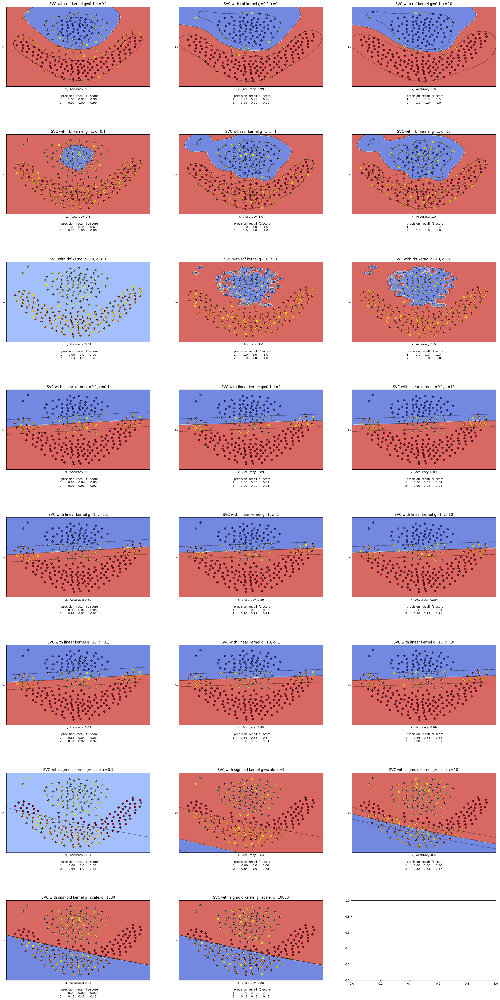

In [469]:
a = print_SVM_plots(df_flame,y_flame,df_flame,y_flame,models,titles,print_SV = True,print_contours = True,return_params_df = True,return_models = False,print_params = True)
a

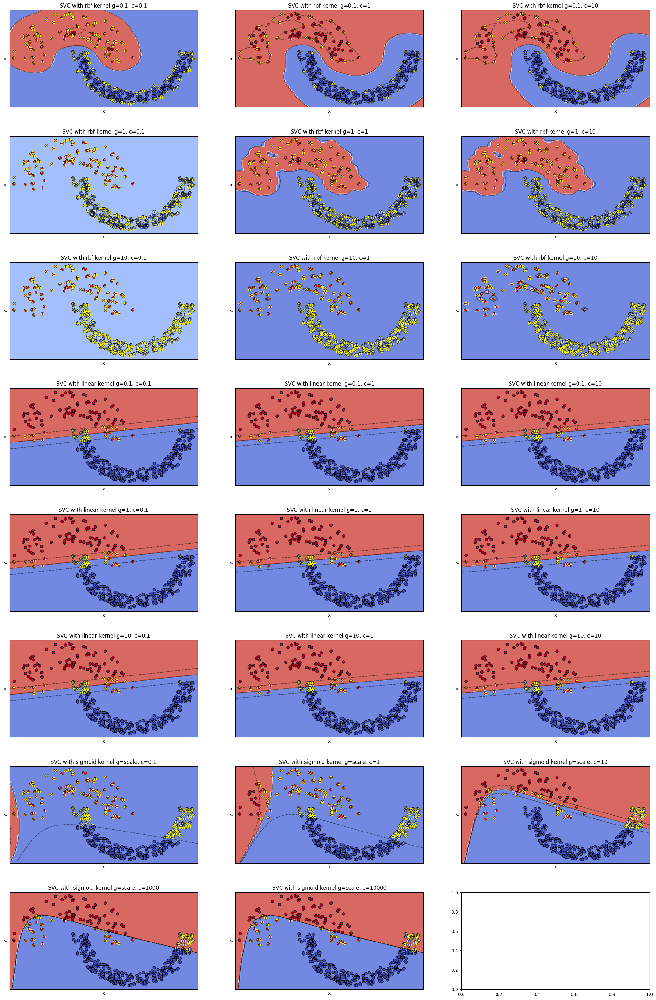

In [233]:
print_SVM_plots(df_jain,y_jain,df_jain,y_jain,models,titles,print_SV = True,print_contours = True)


C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, mo

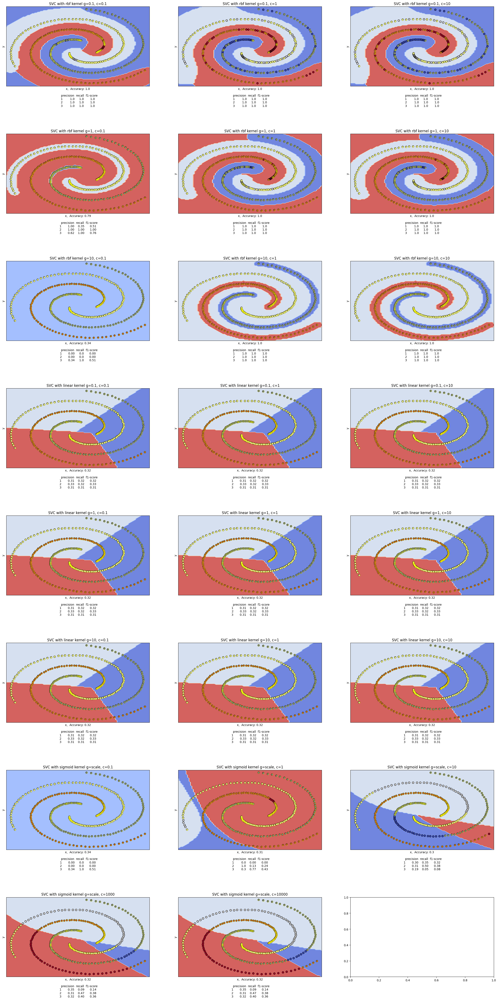

In [470]:
print_SVM_plots(df_spiral,y_spiral,df_spiral,y_spiral,models,titles,print_SV = True,print_contours = False,print_params = True)

C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, mo

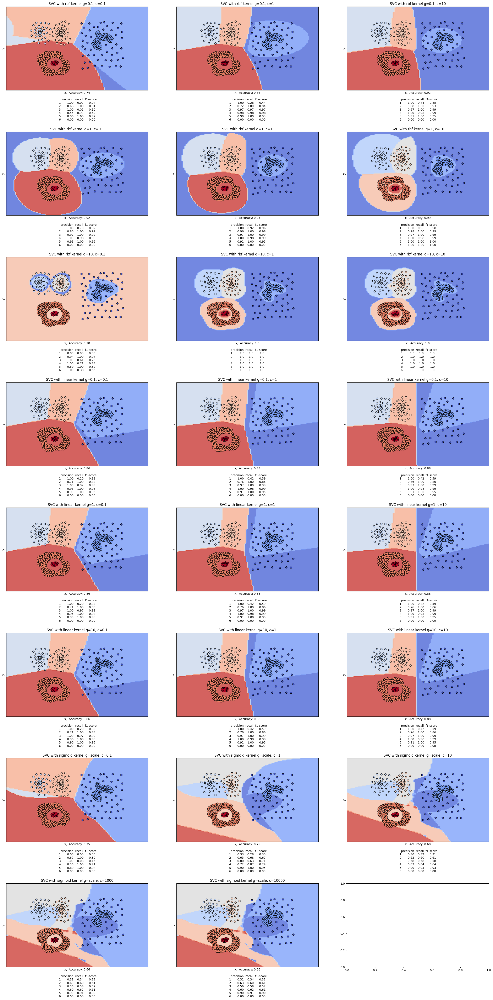

C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, mo

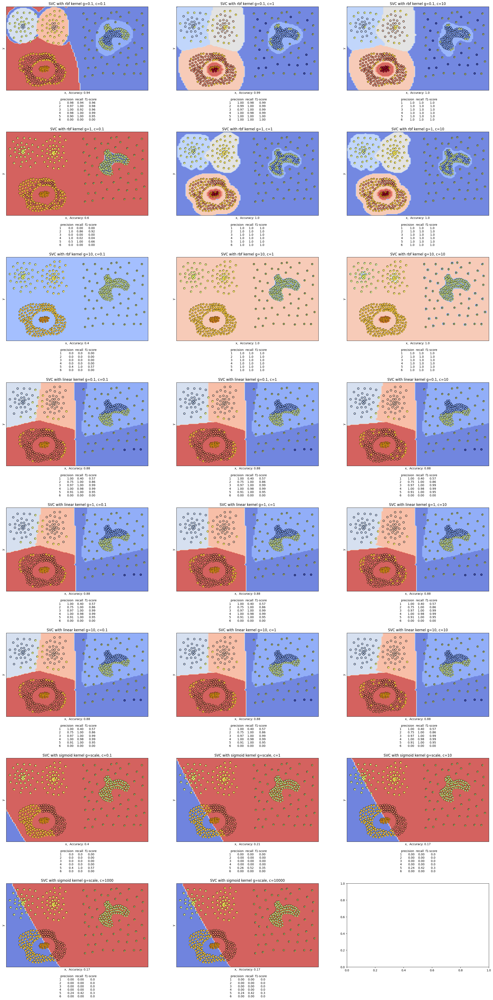

In [474]:
scaler2 = StandardScaler()  
scaler2 = scaler2.fit(df_comp)
X2 = scaler2.transform(df_comp)
X2 = pd.DataFrame(X2, columns = df_comp.columns)
print_SVM_plots(X2,y_comp,X2,y_comp,models,titles,print_SV = False,print_contours = False,print_params = True)
print_SVM_plots(df_comp,y_comp,df_comp,y_comp,models,titles,print_SV = True,print_contours = False,print_params = True)


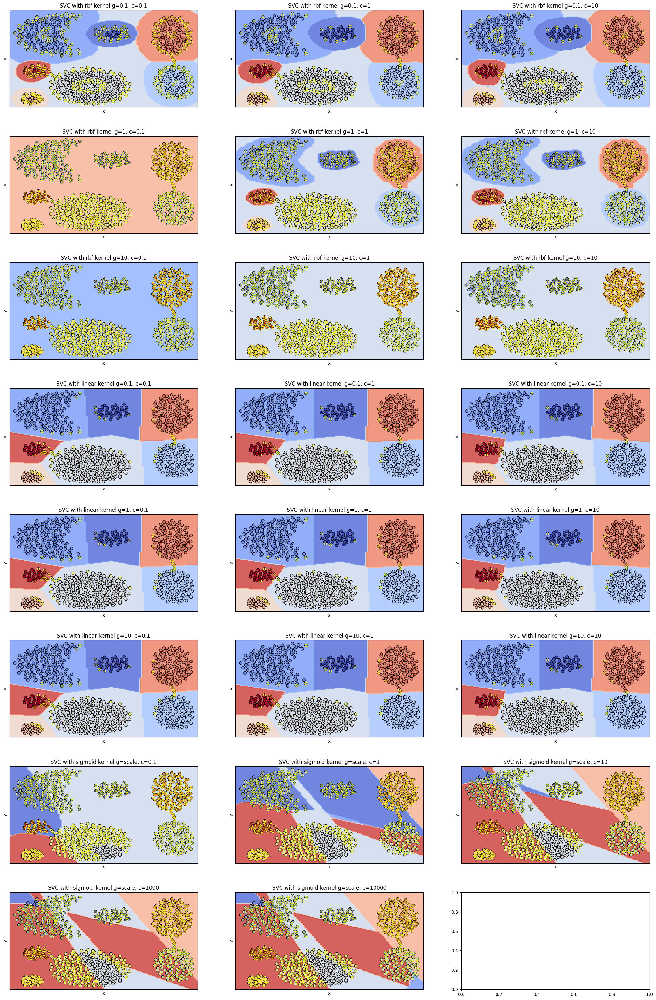

In [237]:
print_SVM_plots(df_aggr,y_aggr,df_aggr,y_aggr,models,titles,print_SV = True,print_contours = False)


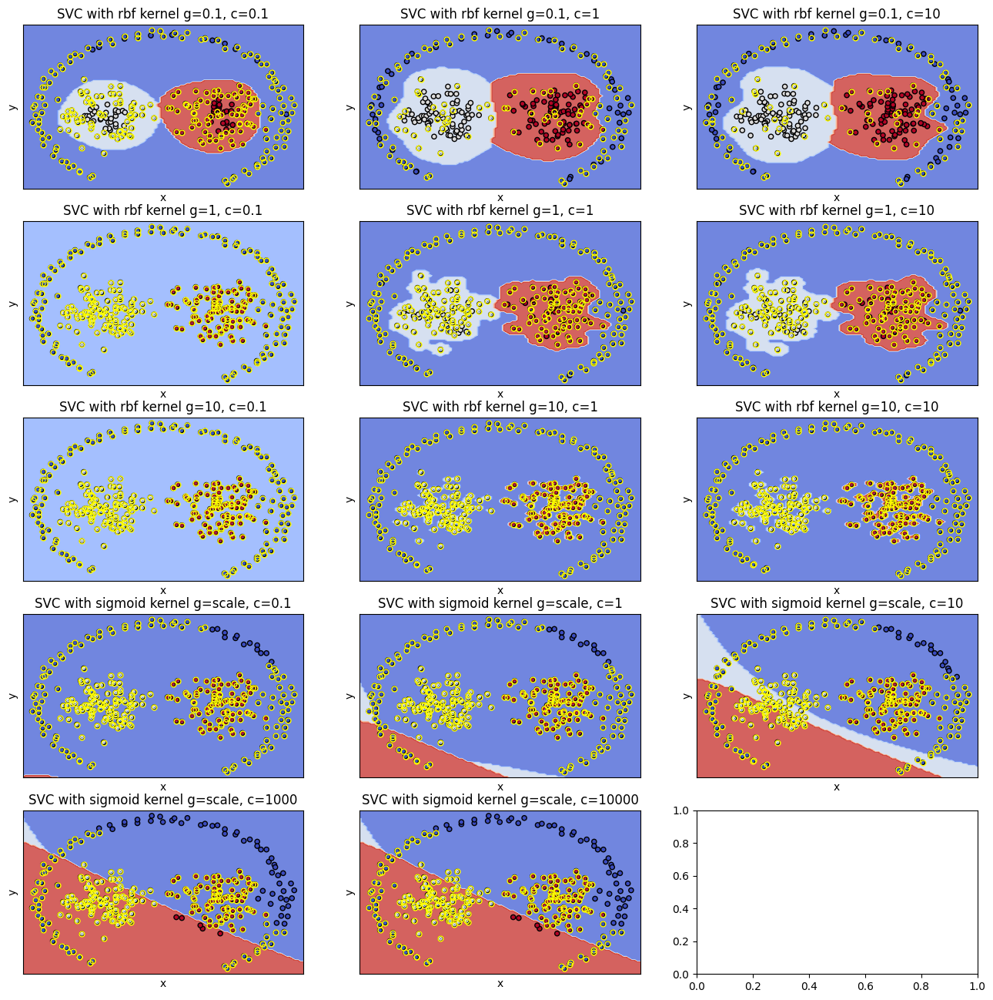

In [192]:
print_SVM_plots(df_path,y_path,df_path,y_path,models,titles,print_SV = True,print_contours = False)

In [355]:
column_names = ['CRIM', 'ZN', 'INDUS', 'CHAS', 'NOX', 'RM', 'AGE', 'DIS', 'RAD', 'TAX', 'PTRATIO', 'B', 'LSTAT', 'MEDV']
df_housing = pd.read_csv('housing.csv', header=None, delimiter=r"\s+", names=column_names)

In [356]:
df_housing

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
0,0.00632,18.0,2.31,0,0.538,6.575,65.2,4.0900,1,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0,0.469,6.421,78.9,4.9671,2,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0,0.469,7.185,61.1,4.9671,2,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0,0.458,6.998,45.8,6.0622,3,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0,0.458,7.147,54.2,6.0622,3,222.0,18.7,396.90,5.33,36.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,0.06263,0.0,11.93,0,0.573,6.593,69.1,2.4786,1,273.0,21.0,391.99,9.67,22.4
502,0.04527,0.0,11.93,0,0.573,6.120,76.7,2.2875,1,273.0,21.0,396.90,9.08,20.6
503,0.06076,0.0,11.93,0,0.573,6.976,91.0,2.1675,1,273.0,21.0,396.90,5.64,23.9
504,0.10959,0.0,11.93,0,0.573,6.794,89.3,2.3889,1,273.0,21.0,393.45,6.48,22.0


<Axes: >

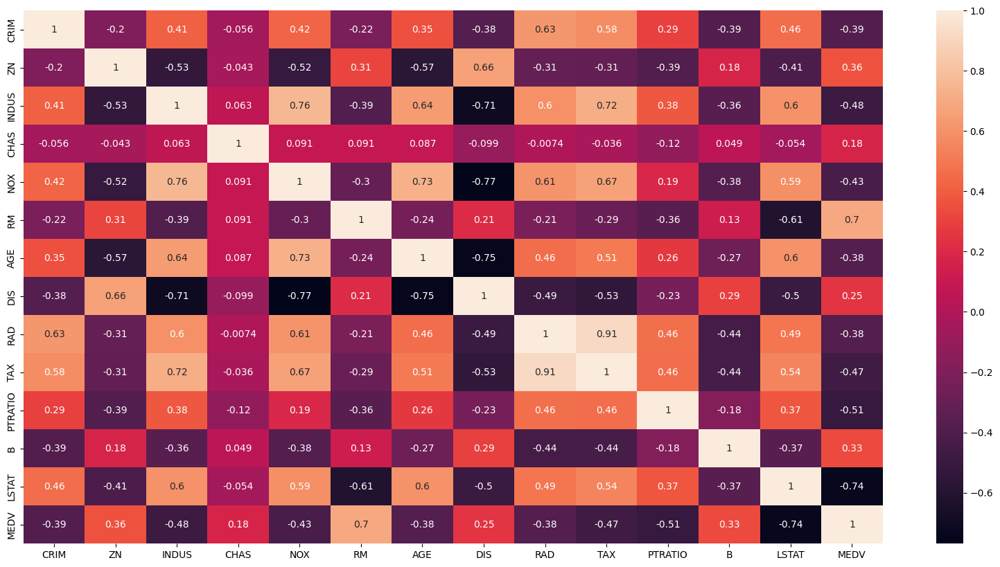

In [357]:
plt.figure(figsize=(20, 10))
sns.heatmap(df_housing.corr(),annot = True)

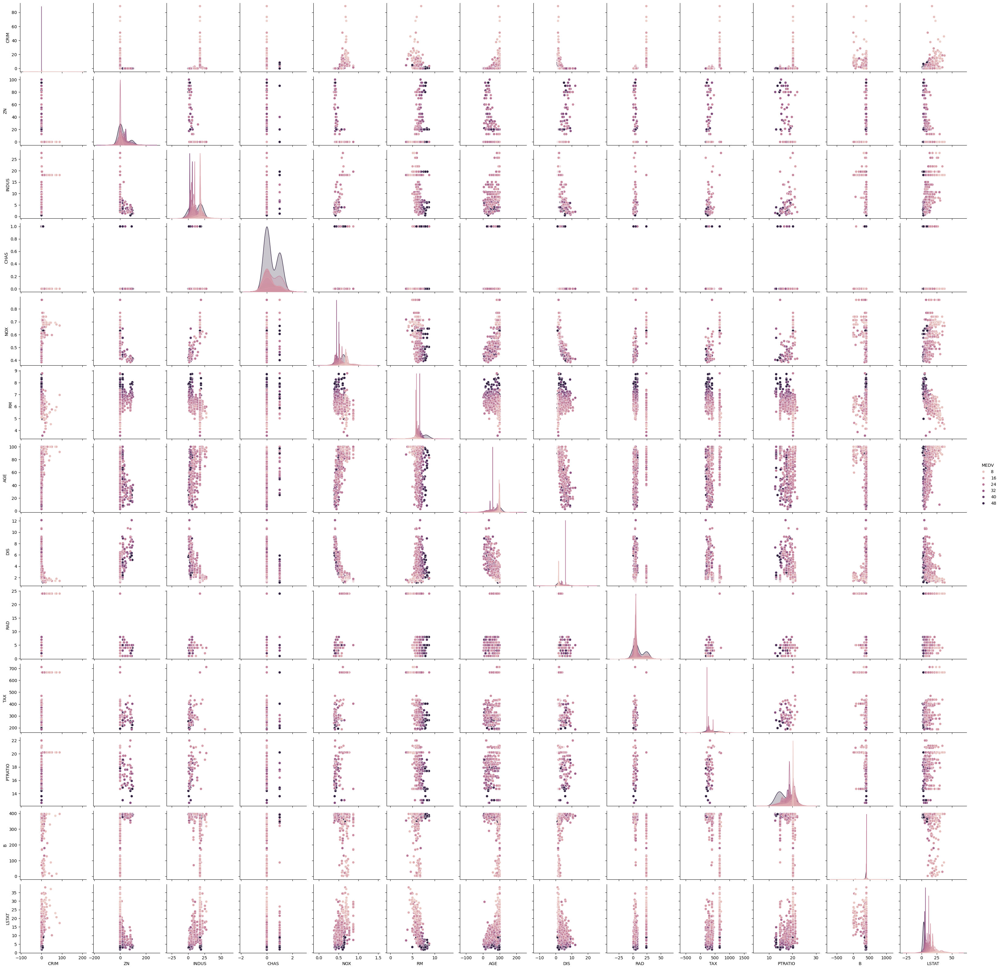

In [89]:
sns.pairplot(data=df_housing, hue = 'MEDV')

In [358]:
y_housing = df_housing['MEDV']
df_housing = df_housing.drop(['MEDV'],axis = 1)

In [359]:
svr_rbf = SVR(kernel='rbf', C=1e3, gamma=0.1)

In [360]:
svr_rbf.fit(df_housing,y_housing)

SVR(C=1000.0, gamma=0.1)

In [361]:
from sklearn.metrics import root_mean_squared_error
root_mean_squared_error(y_housing,svr_rbf.predict(df_housing))

0.09949709701310364

In [362]:
from sklearn import preprocessing
min_max_scaler = preprocessing.MinMaxScaler()

df_housing_sc = pd.DataFrame(min_max_scaler.fit_transform(df_housing),columns = df_housing.columns)

In [363]:
scaler2 = MinMaxScaler()  
scaler2 = scaler2.fit(df_housing)
X2 = scaler2.transform(df_housing)
df_housing_sc = pd.DataFrame(X2,columns = df_housing.columns)

In [364]:
svr_rbf_sc = SVR(kernel='rbf', C=1e3, gamma=0.1)
svr_rbf_sc.fit(df_housing_sc,y_housing)

SVR(C=1000.0, gamma=0.1)

In [365]:
root_mean_squared_error(y_housing,svr_rbf_sc.predict(df_housing_sc))

3.0215716120965244

In [366]:
df_housing_2 = data.loc[:,['LSTAT', 'INDUS', 'RM', 'TAX', 'NOX', 'PTRATIO','AGE']]
svr_rbf3 = SVR(kernel='rbf', C=10000, gamma=0.1)
svr_rbf3.fit(df_housing_2,y_housing)
root_mean_squared_error(y_housing,svr_rbf3.predict(df_housing_2))

0.26743344886376585

In [367]:
scaler2 = MinMaxScaler()  
scaler2 = scaler2.fit(df_housing_2)
X2 = scaler2.transform(df_housing_2)
df_housing_2_sc = pd.DataFrame(X2,columns = df_housing_2.columns)
svr_rbf3 = SVR(kernel='rbf', C=10000, gamma=0.1)
svr_rbf3.fit(df_housing_2_sc,y_housing)
root_mean_squared_error(y_housing,svr_rbf3.predict(df_housing_2_sc))

3.406361668596101

In [412]:
gamma_arr = [0.1,1,10]
c_arr = [0.1,1,10,100,1000,10000]
kernels = ['rbf','sigmoid']
models = []
for kernel in kernels:
    for gamma in gamma_arr:
        for c in c_arr:
            if kernel == 'sigmoid':
                models.append(svm.SVR(kernel=kernel, C=c,gamma = 'scale'))
            else:
                models.append(svm.SVR(kernel=kernel, gamma=gamma, C=c))


titles = []
for kernel in kernels:
    for gamma in gamma_arr:
        for c in c_arr:
            titles.append(f"SVR with {kernel} kernel g={gamma}, c={c}")

c_arr = [0.1,1,10]
kernels = ['linear']
for kernel in kernels:
    for c in c_arr:
        models.append(svm.SVR(kernel=kernel, C=c))
        titles.append(f"SVR with {kernel} kernel c={c}")

degree_arr = [2,3,4,5]
c_arr = [0.1,1,10]
for degree in degree_arr:
    for c in c_arr:
        models.append(svm.SVR(kernel='poly',degree = degree, C=c))
        titles.append(f"SVC with poly kernel degree={degree}, c={c}")





In [415]:
columns_ = ['kernel','gamma', 'C', 'MSE']

res_df = pd.DataFrame(columns = columns_)
for model in models:
    model.fit(df_housing,y_housing)
    df0 = {}
    df0['kernel'] = model.get_params()['kernel']
    df0['gamma'] = model.get_params()['gamma']
    df0['C'] = model.get_params()['C']
    df0['MSE'] = root_mean_squared_error(y_housing,model.predict(df_housing))
    res_df = res_df._append(df0,ignore_index = True)
print(res_df)

C:\Users\fedbe\AppData\Local\Temp\ipykernel_17116\2627173998.py:11: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  res_df = res_df._append(df0,ignore_index = True)


     kernel  gamma        C           MSE
0       rbf    0.1      0.1      9.200287
1       rbf    0.1      1.0      8.503862
2       rbf    0.1     10.0      3.913631
3       rbf    0.1    100.0      0.254680
4       rbf    0.1   1000.0      0.099497
5       rbf    0.1  10000.0      0.099497
6       rbf    1.0      0.1      9.211489
7       rbf    1.0      1.0      8.606944
8       rbf    1.0     10.0      4.254134
9       rbf    1.0    100.0      0.099383
10      rbf    1.0   1000.0      0.099383
11      rbf    1.0  10000.0      0.099383
12      rbf   10.0      0.1      9.211965
13      rbf   10.0      1.0      8.610979
14      rbf   10.0     10.0      4.249008
15      rbf   10.0    100.0      0.099429
16      rbf   10.0   1000.0      0.099429
17      rbf   10.0  10000.0      0.099429
18  sigmoid  scale      0.1      9.047954
19  sigmoid  scale      1.0      9.227225
20  sigmoid  scale     10.0     42.222322
21  sigmoid  scale    100.0    430.556967
22  sigmoid  scale   1000.0   4274

In [374]:
import matplotlib.pyplot as plt

from sklearn import datasets, svm
from sklearn.inspection import DecisionBoundaryDisplay

degree_arr = [2,3,4,5,6]
c_arr = [0.1,1,10]
models = []
for degree in degree_arr:
    for c in c_arr:
        models.append(svm.SVC(kernel='poly',degree = degree, C=c))


titles = []
for degree in degree_arr:
    for c in c_arr:
        titles.append(f"SVC with poly kernel degree={degree}, c={c}")
print(len(models))
   

15


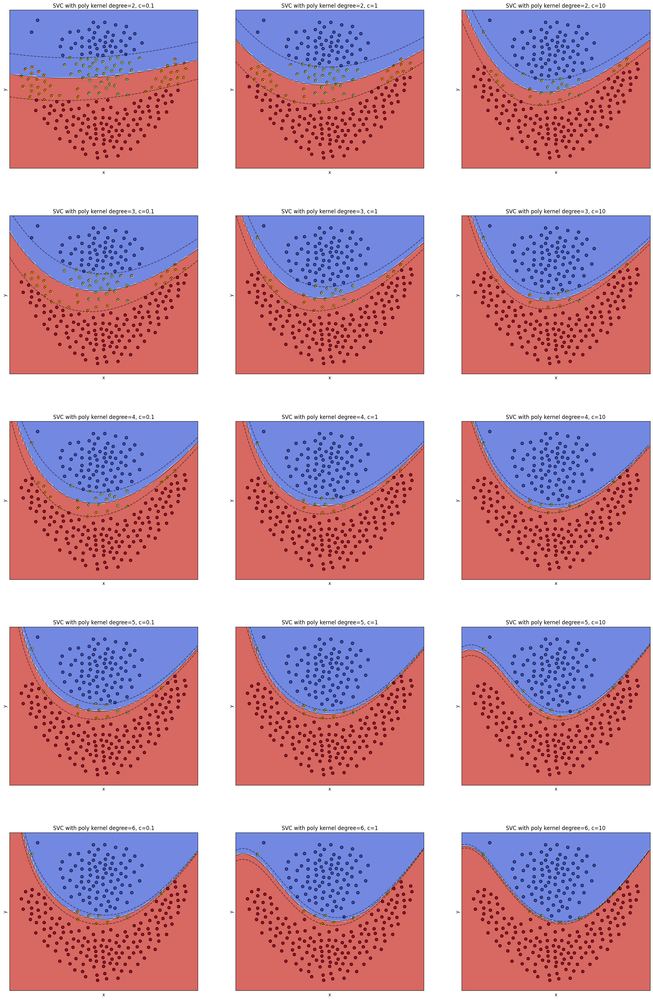

In [375]:
print_SVM_plots(df_flame,y_flame,df_flame,y_flame,models,titles,print_SV = True,print_contours = True)


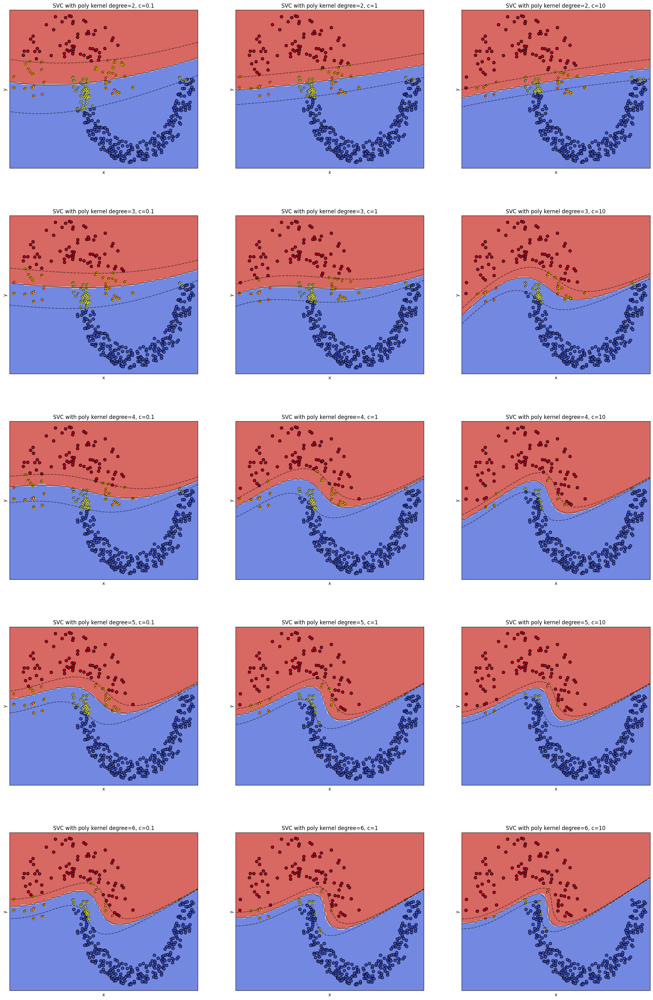

In [376]:
print_SVM_plots(df_jain,y_jain,df_jain,y_jain,models,titles,print_SV = True,print_contours = True)


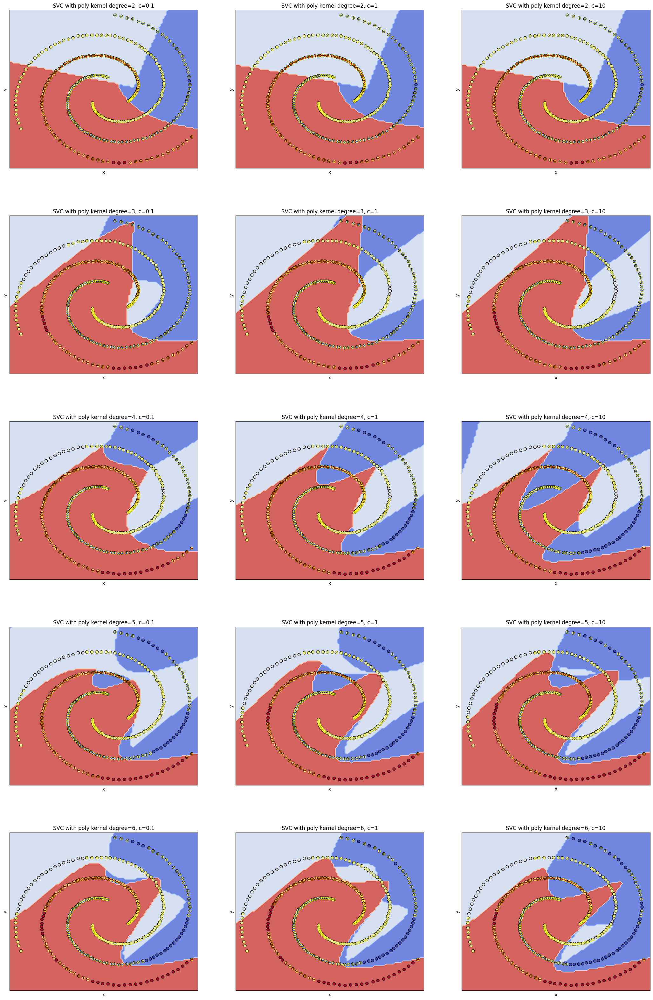

In [377]:
print_SVM_plots(df_spiral,y_spiral,df_spiral,y_spiral,models,titles,print_SV = True,print_contours = False)


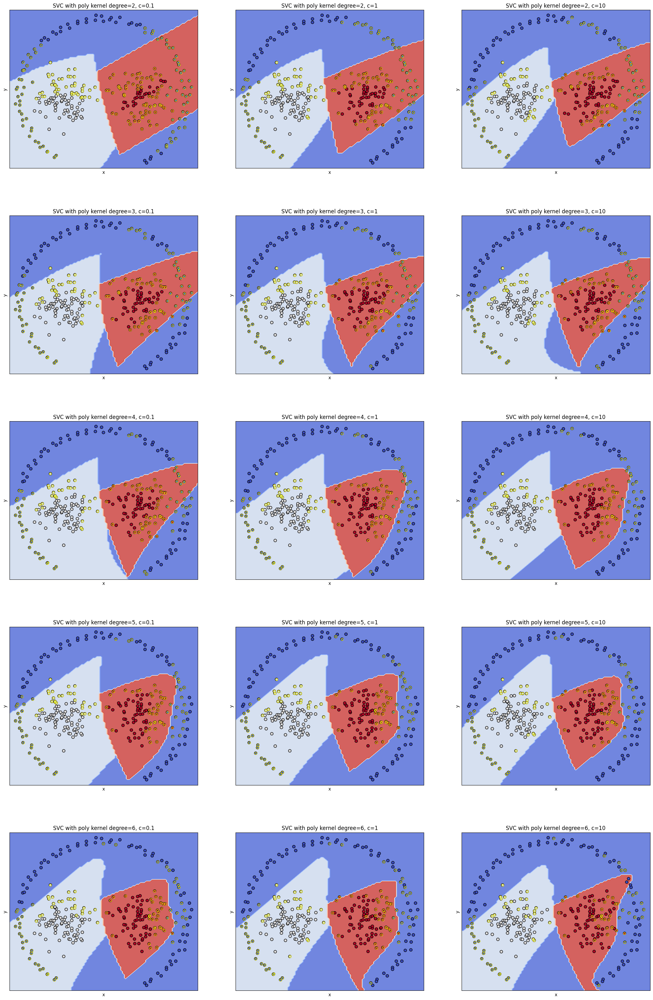

In [378]:
print_SVM_plots(df_path,y_path,df_path,y_path,models,titles,print_SV = True,print_contours = False)

In [430]:
model = svm.SVC(kernel='rbf',C=10000)

In [431]:
from ucimlrepo import fetch_ucirepo 
  
# fetch dataset 
heart_disease = fetch_ucirepo(id=45) 
  
# data (as pandas dataframes) 
X = heart_disease.data.features 
y = heart_disease.data.targets 
X = X.ffill().bfill()


In [432]:
model.fit(X,y)

C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


SVC(C=10000)

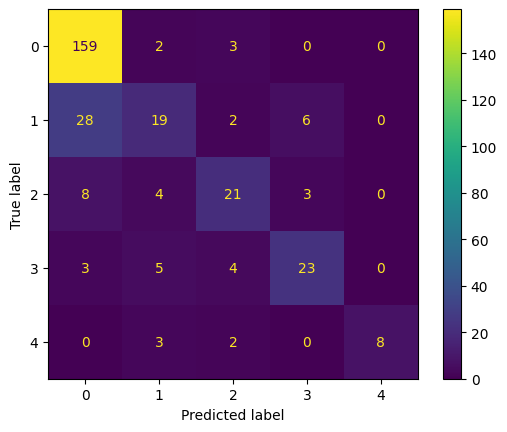

In [433]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(model, X, y)


In [435]:
gamma_arr = [0.1,1,10]
c_arr = [0.1,1,10,100,1000,10000]
kernels = ['rbf','sigmoid']
models = []
for kernel in kernels:
    for gamma in gamma_arr:
        for c in c_arr:
            if kernel == 'sigmoid':
                models.append(svm.SVC(kernel=kernel, C=c,gamma = 'scale'))
            else:
                models.append(svm.SVC(kernel=kernel, gamma=gamma, C=c))


titles = []
for kernel in kernels:
    for gamma in gamma_arr:
        for c in c_arr:
            titles.append(f"SVR with {kernel} kernel g={gamma}, c={c}")

c_arr = [0.1,1,10]
kernels = ['linear']
for kernel in kernels:
    for c in c_arr:
        models.append(svm.SVC(kernel=kernel, C=c))
        titles.append(f"SVR with {kernel} kernel c={c}")

degree_arr = [2,3,4,5]
c_arr = [0.1,1,10]
for degree in degree_arr:
    for c in c_arr:
        models.append(svm.SVC(kernel='poly',degree = degree, C=c))
        titles.append(f"SVC with poly kernel degree={degree}, c={c}")





C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:1339: DataC

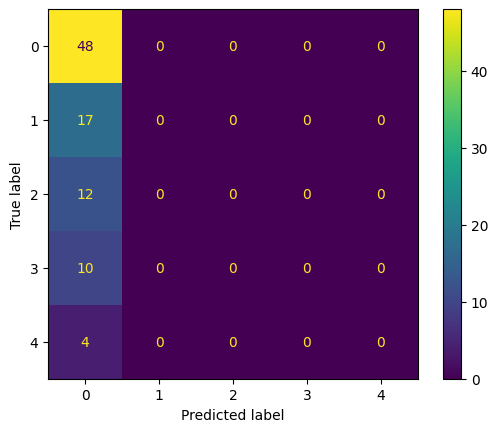

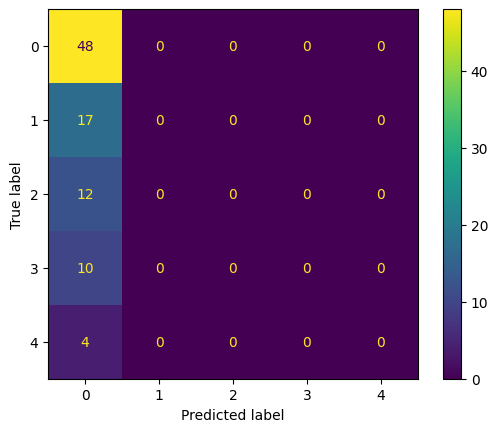

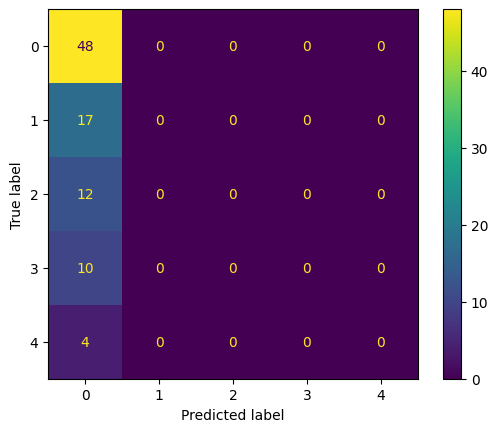

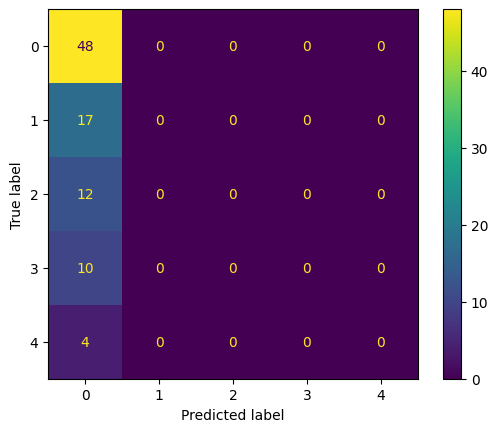

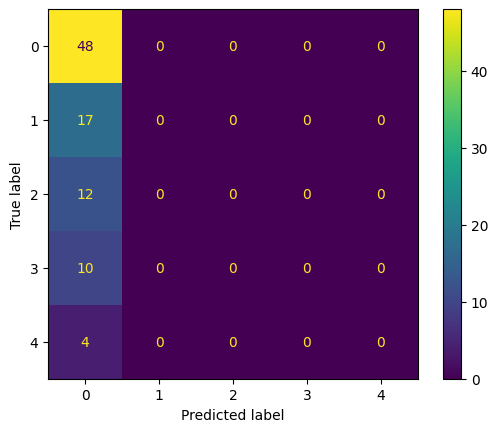

...

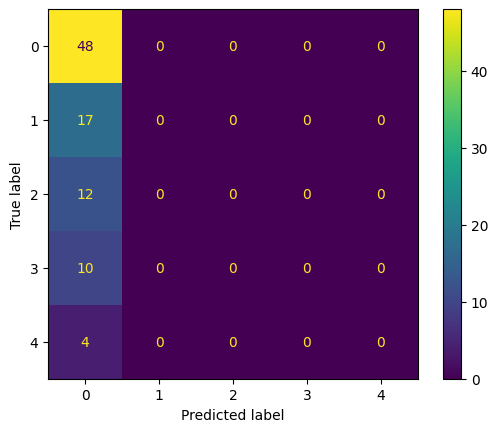

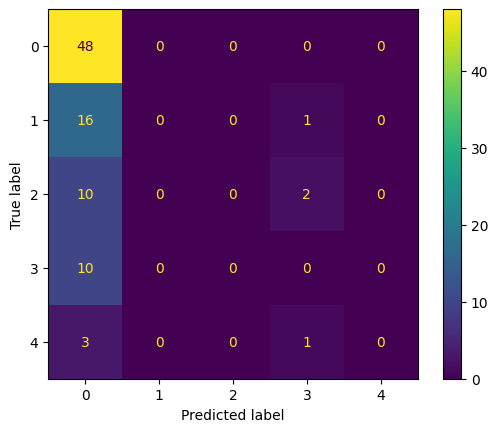

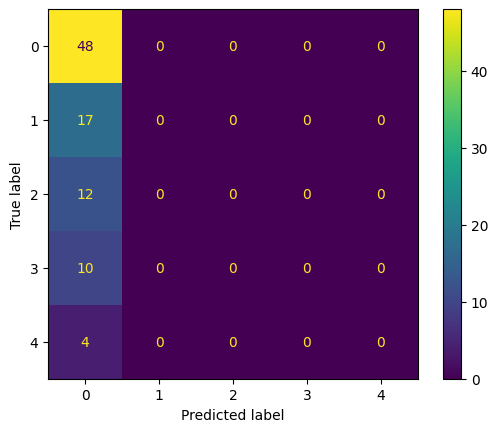

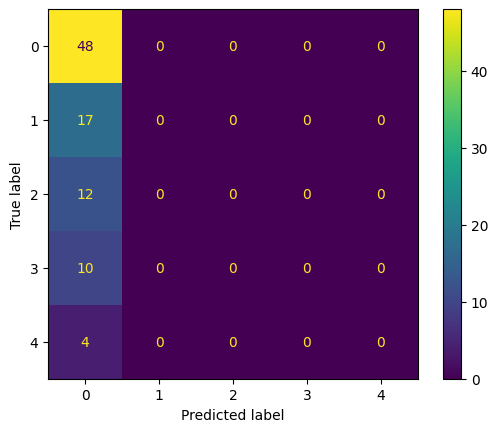

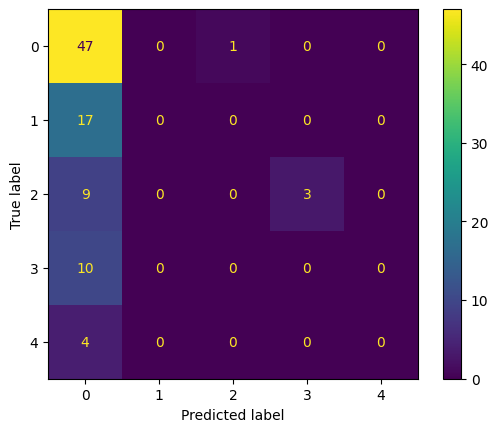

In [438]:
columns_ = ['kernel','gamma', 'C', 'MSE']

res_df = pd.DataFrame(columns = columns_)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
for model in models:
    model.fit(X_train,y_train)
    ConfusionMatrixDisplay.from_estimator(model, X_test, y_test)



In [453]:
def print_SVM_stats(X_train,y_train,X_test,y_test,models):
    m = len(models) // 3 if len(models) % 3 == 0 else len(models) // 3 + 1
    models = (clf.fit(X_train, y_train) for clf in models)
    
    # Set-up 2x2 grid for plotting.

    my = max(y_train)
    if True:
        columns_ = ['kernel','gamma', 'C']
        for i in range(5):
            columns_.append(f'prec_{i}')
            columns_.append(f'recall_{i}')
            columns_.append(f'f1_score_{i}')
        columns_.append('accuracy')
        columns_.append('prec_mid')
        columns_.append('recall_mid')
        res_df = pd.DataFrame(columns = columns_)

    for clf in models:
        cr = classification_report(y_test, clf.predict(X_test), output_dict = True)
        #print(cr)
        df0 = {}
        df0['kernel'] = clf.get_params()['kernel']
        df0['gamma'] = clf.get_params()['gamma']
        df0['C'] = clf.get_params()['C']
        sum_prec = 0
        sum_recall = 0
        for i in range(5):
            df0[f'prec_{i}'] = cr[f'{i}']['precision']
            df0[f'recall_{i}'] = cr[f'{i}']['recall']
            df0[f'f1_score_{i}'] = cr[f'{i}']['f1-score']
            sum_prec += cr[f'{i}']['precision']
            sum_recall += cr[f'{i}']['recall']
        df0['accuracy'] = cr['accuracy']
        print(sum_recall)
        df0['prec_mid'] = sum_prec / 5
        df0['recall_mid'] = sum_recall / 5
        res_df = res_df._append(df0, ignore_index = True)

    return res_df
    
    plt.show()

In [455]:
res = print_SVM_stats(X_train, y_train, X_test, y_test,models)

C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\U

1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0


C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, mo

1.0
1.0
1.0
1.0
1.0
1.0
0.8676470588235294
0.8223039215686275
0.8014705882352942
0.8602941176470589
1.0
1.0
0.8676470588235294
0.8223039215686275
0.8014705882352942
0.8602941176470589
1.0
1.0
0.8676470588235294
0.8223039215686275
0.8014705882352942
0.8602941176470589


C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, mo

1.5463235294117648
1.8607843137254902


C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


1.6492647058823529
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.9791666666666666


C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\U

In [456]:
res

,kernel,gamma,C,prec_0,recall_0,f1_score_0,prec_1,recall_1,f1_score_1,prec_2,...,f1_score_2,prec_3,recall_3,f1_score_3,prec_4,recall_4,f1_score_4,accuracy,prec_mid,recall_mid
0,rbf,0.1,0.1,0.527473,1.000000,0.690647,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.527473,0.105495,0.200000
1,rbf,0.1,1.0,0.527473,1.000000,0.690647,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.527473,0.105495,0.200000
2,rbf,0.1,10.0,0.527473,1.000000,0.690647,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.527473,0.105495,0.200000
3,rbf,0.1,100.0,0.527473,1.000000,0.690647,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.527473,0.105495,0.200000
4,rbf,0.1,1000.0,0.527473,1.000000,0.690647,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.527473,0.105495,0.200000
5,rbf,0.1,10000.0,0.527473,1.000000,0.690647,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.527473,0.105495,0.200000
6,rbf,1.0,0.1,0.527473,1.000000,0.690647,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.527473,0.105495,0.200000
7,rbf,1.0,1.0,0.527473,1.000000,0.690647,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.527473,0.105495,0.200000
8,rbf,1.0,10.0,0.527473,1.000000,0.690647,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.527473,0.105495,0.200000
9,rbf,1.0,100.0,0.527473,1.000000,0.690647,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.527473,0.105495,0.200000


In [459]:
gamma_arr = [0.01,0.1,1,10]
c_arr = [0.1,1,10,0.3667]
kernels = ['rbf','linear']
models = []
for kernel in kernels:
    for gamma in gamma_arr:
        for c in c_arr:
            if kernel == 'linear':
                models.append(svm.SVC(kernel=kernel, C=c))
            else:
                models.append(svm.SVC(kernel=kernel, gamma=gamma, C=c))


titles = []
for kernel in kernels:
    for gamma in gamma_arr:
        for c in c_arr:
            titles.append(f"SVC with {kernel} kernel g={gamma}, c={c}")


c_arr = [0.1,1,10,1000,10000]
gamma_arr = ['scale']
kernel = 'sigmoid'
for gamma in gamma_arr:
    for c in c_arr:
        models.append(svm.SVC(kernel=kernel, gamma=gamma, C=c))

for gamma in gamma_arr:
    for c in c_arr:
        titles.append(f"SVC with {kernel} kernel g={gamma}, c={c}")

C:\Users\fedbe\AppData\Local\Temp\ipykernel_17116\2051346932.py:107: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  res_df = res_df._append(df0, ignore_index = True)
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\fedbe\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_divi

,kernel,gamma,C,prec_1,recall_1,f1_score_1,prec_2,recall_2,f1_score_2,prec_3,...,f1_score_5,prec_6,recall_6,f1_score_6,prec_7,recall_7,f1_score_7,accuracy,prec_mid,recall_mid
0,rbf,0.01,0.1000,1.0,1.0,1.0,1.000000,1.000000,1.000000,0.990291,...,1.000000,1.0,0.992308,0.996139,1.000000,1.000000,1.000000,0.998731,0.998613,0.998901
1,rbf,0.01,1.0000,1.0,1.0,1.0,1.000000,1.000000,1.000000,0.990291,...,1.000000,1.0,0.992308,0.996139,1.000000,1.000000,1.000000,0.998731,0.998613,0.998901
2,rbf,0.01,10.0000,1.0,1.0,1.0,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
3,rbf,0.01,0.3667,1.0,1.0,1.0,1.000000,1.000000,1.000000,0.990291,...,1.000000,1.0,0.992308,0.996139,1.000000,1.000000,1.000000,0.998731,0.998613,0.998901
4,rbf,0.1,0.1000,1.0,1.0,1.0,1.000000,1.000000,1.000000,0.990291,...,1.000000,1.0,0.992308,0.996139,1.000000,1.000000,1.000000,0.998731,0.998613,0.998901
5,rbf,0.1,1.0000,1.0,1.0,1.0,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,rbf,0.1,10.0000,1.0,1.0,1.0,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,rbf,0.1,0.3667,1.0,1.0,1.0,1.000000,1.000000,1.000000,0.990291,...,1.000000,1.0,0.992308,0.996139,1.000000,1.000000,1.000000,0.998731,0.998613,0.998901
8,rbf,1.0,0.1000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,...,0.111111,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.348985,0.192475,0.151261
9,rbf,1.0,1.0000,1.0,1.0,1.0,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


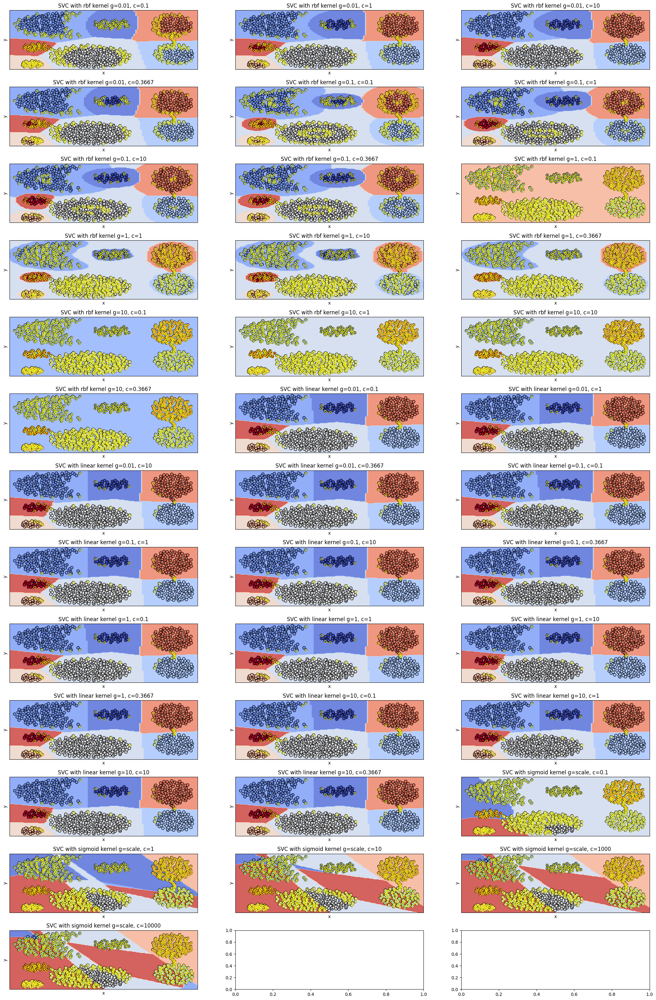

In [461]:
print_SVM_plots(df_aggr,y_aggr,df_aggr,y_aggr,models,titles,print_SV = True,print_contours = False,return_params_df = True)
